# Post-scVI analysis of donor P13 data (nuclei), all cell states

After LF gene filter, with final annotation labels - just for a manifold in supplementary

This the version of the manifold after running scVI by `sample` and removing genes that have been filtered according to high ambient RNA in notebook in all-donors analysis

02.2022

What happens here:
- load preprocessed object (raw filtered)
- do normalising & log transforming
- save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- calculate neighborhood graph on the latent dimensionality reporesentation from scVI
- umap
- unbiased clustering
- save

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import anndata
import bbknn
import scrublet as scr
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.5
annoy               NA
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
bbknn               NA
brotli              NA
cairo               1.20.0
certifi             2020.12.05
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyte

In [4]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202111_MFI_sc_sn_new_scVI_analysis/'

## Reading the preprocessed object

Preprocessing happened in M0 notebook

In [5]:
# reading the raw filtered object from joint analysis
adata = sc.read(save_path + 'adata_raw_filtered.h5ad')

In [6]:
# read in final annotations
final_annot = pd.read_csv(save_path + 'final_annotation_all_cells_and_nulcei_20211123.csv', index_col=0)
final_annot['cell_type'].value_counts()

dS2               65746
dS1               42586
SCT               28177
VCT               23472
uSMC              17043
dEpi_secretory    16834
dM1               14099
dS3               13197
dNK2              12487
HOFB              10733
dNK1              10450
fF1               10420
PV                 9980
dT_cells           9740
dM2                9221
Endo_M             6877
VCT_p              6679
EVT_1              5289
NK                 5187
iEVT               3676
VCT_CCC            3373
MO                 3050
dNK3               2952
ILC3               2511
EVT_2              2358
T_cells            2126
VCT_fusing         1971
dT_regs            1862
Endo_L             1761
Endo_F             1466
fF2                1396
M3                 1299
B_cells             774
DC                  697
dDC                 694
Plasma              255
Granulocytes        195
dEpi_lumenal        135
eEVT                 28
GC                   19
Name: cell_type, dtype: int64

In [7]:
len(final_annot)

350815

In [8]:
# subset adata to only final cells + nuclei and transfer annotations
adata = adata[final_annot.index,:]
adata.obs['cell_type'] = final_annot.loc[adata.obs_names,'cell_type']

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.obs` of view, copying.


In [9]:
adata.obs['donor'].value_counts()

P13        67821
Hrv43      60837
P14        45166
Hrv46      29619
8          18940
10         16943
9          14869
P34        13972
12         13842
Hrv100     13708
6          11683
Hrv98      11189
Hrv99       9680
7           9596
H2          5946
H7 + H9     3608
11          3396
Name: donor, dtype: int64

In [10]:
# subset to only donor P13 data, all cell types
adata = adata[adata.obs['donor'] == 'P13']

In [11]:
adata

View of AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 'n_cells-18', 'gene_ids-1

In [12]:
np.unique(adata.obs['sample'])

array(['Pla_Camb10691970', 'Pla_Camb10691971', 'Pla_Camb10714919',
       'Pla_Camb10714920', 'WSSS_PLA8764121', 'WSSS_PLA8764122',
       'WSSS_PLA8810750', 'WSSS_PLA8810751'], dtype=object)

In [13]:
# quick check to see if raw is raw or not
expr_mtx_dense = adata[adata.obs['sample'] == 'Pla_Camb10691970'].X.todense()

In [14]:
# YAS we all good
np.unique(expr_mtx_dense)

matrix([[   0.,    0.,    0., ..., 3369., 4637., 6366.]], dtype=float32)

In [15]:
adata.obs['technology'].value_counts()

10X_3'_snRNA-seq    57781
10X_multiome        10040
Name: technology, dtype: int64

________

Carrying on to 
- Normalise and log transform
- Save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- Make cell names (obs) and gene names (var) unique

In [16]:
# normalise and log transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

# saving normalised and log transformed values into the raw attribute to later be able to plot
adata.raw = adata.copy()

adata.var_names_make_unique()
adata.obs_names_make_unique()

normalizing by total count per cell
Trying to set attribute `.obs` of view, copying.
    finished (0:00:04): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


_____________________________________________________________________________________________________________________________________________________________

In [17]:
# Assign cell cycle stage & scores
cell_cycle_genes = [x.strip() for x in open(file='/home/jovyan/notebooks/Vento_Lab/regev_lab_cell_cycle_genes_from_Luz_20200505.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
s_genes = [x for x in s_genes if x in adata.var_names]
g2m_genes = [x for x in g2m_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    586 total control genes are used. (0:00:02)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    502 total control genes are used. (0:00:02)
-->     'phase', cell cycle phase (adata.obs)


In [18]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

_______________________________________________________________________________________________________

# Read in scVI-calculated latent representation

In [20]:
# in this case we only used 16 PCs, but also experimented with the layers
n_latent = [9,14]
n_layers = [1,2,3]

### 19.02.2022 run, correction by `sample`

In [23]:
latent_representations = {}

latent_representations['n_latent_9'] = {}
latent_representations['n_latent_14'] = {}

for n_latent_value in n_latent:
    print('n_latent_value', n_latent_value)
    latent_representations['n_latent_' + str(n_latent_value)] = {}
    
    for n_layers_value in n_layers:
        print('n_layers_value', n_layers_value)

        curr_path = '/nfs/team292/aa22/scVI_related/202111_upd_in_vivo_analysis/donor_P13_analysis/20220219_obsm_with_scVI_latent_representation_n_latent_' + str(n_latent_value) + '_n_layers_' + str(n_layers_value) + '_with_LF_gene_filter_donor_P13_all_cell_states.csv' 

        latent_representations['n_latent_' + str(n_latent_value)]['n_layers_' + str(n_layers_value)] = pd.read_csv(curr_path, index_col=0)
        

n_latent_value 9
n_layers_value 1
n_layers_value 2
n_layers_value 3
n_latent_value 14
n_layers_value 1
n_layers_value 2
n_layers_value 3


In [26]:
# assign these latent_representations into adata.obsm
for n_latent_value in n_latent:
    print('n_latent_value', n_latent_value)
    for n_layers_value in n_layers:
        print('n_layers_value', n_layers_value)
        adata.obsm['X_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_' + str(n_layers_value)] = np.array(latent_representations['n_latent_' + str(n_latent_value)]['n_layers_' + str(n_layers_value)])

n_latent_value 9
n_layers_value 1
n_layers_value 2
n_layers_value 3
n_latent_value 14
n_layers_value 1
n_layers_value 2
n_layers_value 3


In [25]:
adata.obsm['X_scVI_n_latent_14_sample_n_layers_1'].shape

(67821, 14)

__________________________________________________________________________________________________________________________________________________________________

### Neighbourhood graph & UMAP

In [27]:
%%time

for n_latent_value in n_latent:
    print('n_latent_value', n_latent_value)
    for n_layers_value in n_layers:
        print('n_layers_value', n_layers_value)
        sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_' + str(n_layers_value),
               key_added='neighbors_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_' + str(n_layers_value))

computing neighbors


n_latent_value 9
n_layers_value 1


    finished: added to `.uns['neighbors_scVI_n_latent_9_sample_n_layers_1']`
    `.obsp['neighbors_scVI_n_latent_9_sample_n_layers_1_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_9_sample_n_layers_1_connectivities']`, weighted adjacency matrix (0:00:20)
computing neighbors


n_layers_value 2


    finished: added to `.uns['neighbors_scVI_n_latent_9_sample_n_layers_2']`
    `.obsp['neighbors_scVI_n_latent_9_sample_n_layers_2_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_9_sample_n_layers_2_connectivities']`, weighted adjacency matrix (0:00:07)
computing neighbors


n_layers_value 3


    finished: added to `.uns['neighbors_scVI_n_latent_9_sample_n_layers_3']`
    `.obsp['neighbors_scVI_n_latent_9_sample_n_layers_3_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_9_sample_n_layers_3_connectivities']`, weighted adjacency matrix (0:00:07)
computing neighbors


n_latent_value 14
n_layers_value 1


    finished: added to `.uns['neighbors_scVI_n_latent_14_sample_n_layers_1']`
    `.obsp['neighbors_scVI_n_latent_14_sample_n_layers_1_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_14_sample_n_layers_1_connectivities']`, weighted adjacency matrix (0:00:08)
computing neighbors


n_layers_value 2


    finished: added to `.uns['neighbors_scVI_n_latent_14_sample_n_layers_2']`
    `.obsp['neighbors_scVI_n_latent_14_sample_n_layers_2_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_14_sample_n_layers_2_connectivities']`, weighted adjacency matrix (0:00:07)
computing neighbors


n_layers_value 3


    finished: added to `.uns['neighbors_scVI_n_latent_14_sample_n_layers_3']`
    `.obsp['neighbors_scVI_n_latent_14_sample_n_layers_3_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_14_sample_n_layers_3_connectivities']`, weighted adjacency matrix (0:00:07)


CPU times: user 1min 30s, sys: 4min 41s, total: 6min 12s
Wall time: 58.9 s


In [28]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

__________________________________________________________________________________________________________________________________________________________________

In [29]:
%%time
# takes about 20 minutes
for n_latent_value in n_latent:
    print('n_latent_value', n_latent_value)
    for n_layers_value in n_layers:
        print('n_layers_value', n_layers_value)
    
        sc.tl.umap(adata, random_state=0,
                  neighbors_key='neighbors_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_' + str(n_layers_value))
        # copy current adata.obsm['X_umap'] into adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value)]
        adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_' + str(n_layers_value)] = adata.obsm['X_umap']



computing UMAP


n_latent_value 9
n_layers_value 1


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:45)
computing UMAP


n_layers_value 2


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:45)
computing UMAP


n_layers_value 3


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:44)
computing UMAP


n_latent_value 14
n_layers_value 1


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:46)
computing UMAP


n_layers_value 2


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:45)
computing UMAP


n_layers_value 3


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:46)


CPU times: user 17min, sys: 13min 59s, total: 30min 59s
Wall time: 4min 34s


In [30]:
np.unique(adata.obs['sample'], return_counts=True)

(array(['Pla_Camb10691970', 'Pla_Camb10691971', 'Pla_Camb10714919',
        'Pla_Camb10714920', 'WSSS_PLA8764121', 'WSSS_PLA8764122',
        'WSSS_PLA8810750', 'WSSS_PLA8810751'], dtype=object),
 array([ 8952,  8934,  4922,  5118,  7819,  7591, 13259, 11226]))

In [31]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

## Saving this object with all the manifolds calculated

In [32]:
adata.write(save_path + 'adata_scVI_analysed_corr_by_sample_all_cells_and_nuclei_with_LF_gene_filter_donor_P13.h5ad')


... storing 'cell_type' as categorical
... storing 'phase' as categorical


In [ ]:
# reading the previously saved file
adata = sc.read(save_path + 'adata_scVI_analysed_corr_by_sample_all_cells_and_nuclei_with_LF_gene_filter_donor_P13.h5ad')


In [33]:
colors_final_df = pd.DataFrame(index = np.unique(adata.obs['cell_type']))
#colors_final_df['color'] = colors_final

In [34]:
colors_final_df

""
B_cells
DC
EVT_1
EVT_2
Endo_F
Endo_L
Endo_M
GC
Granulocytes
HOFB


In [35]:
colors_final_df.loc['B_cells', 'color'] = '#e3cee4'
colors_final_df.loc['DC', 'color'] = '#d6d4eb'
colors_final_df.loc['EVT_1', 'color'] = '#d895ea'
colors_final_df.loc['EVT_2', 'color'] = '#9f6bac'
colors_final_df.loc['Endo_F', 'color'] = '#b9a96b'
colors_final_df.loc['Endo_L', 'color'] = '#f8f4a8'
colors_final_df.loc['Endo_M', 'color'] = '#eacf68'
colors_final_df.loc['GC', 'color'] = '#DBC7DE'
colors_final_df.loc['Granulocytes', 'color'] = '#7673ae'
colors_final_df.loc['HOFB', 'color'] = '#69b4ce'
colors_final_df.loc['ILC3', 'color'] = '#497c76'
colors_final_df.loc['M3', 'color'] = '#cbebf6'
colors_final_df.loc['MO', 'color'] = '#7a8dbb'
colors_final_df.loc['NK', 'color'] = '#7aaf93'
colors_final_df.loc['PV', 'color'] = '#6b6a6b'
colors_final_df.loc['Plasma', 'color'] = 'yellow'
colors_final_df.loc['SCT', 'color'] = '#eb5376'
colors_final_df.loc['T_cells', 'color'] = '#f8e6df'
colors_final_df.loc['VCT', 'color'] = '#ecdbe5'
colors_final_df.loc['VCT_CCC', 'color'] = '#e7a3c8'
colors_final_df.loc['VCT_fusing', 'color'] = '#b53279'
colors_final_df.loc['VCT_p', 'color'] = '#e96db3'
colors_final_df.loc['dDC', 'color'] = '#d5e7f7'
colors_final_df.loc['dEpi_lumenal', 'color'] = '#863829'
colors_final_df.loc['dEpi_secretory', 'color'] = '#c35338'
colors_final_df.loc['dM1', 'color'] = '#588198'
colors_final_df.loc['dM2', 'color'] = '#66cef6'
colors_final_df.loc['dNK1', 'color'] = '#deeab1'
colors_final_df.loc['dNK2', 'color'] = '#63b472'
colors_final_df.loc['dNK3', 'color'] = '#2d563c'

colors_final_df.loc['dS1', 'color'] = '#c9bdb2'
colors_final_df.loc['dS2', 'color'] = '#f5c785'
colors_final_df.loc['dS3', 'color'] = '#eaa944'
colors_final_df.loc['dT_cells', 'color'] = '#d7587b'
colors_final_df.loc['dT_regs', 'color'] = '#B85E52'
colors_final_df.loc['eEVT', 'color'] = '#FF1200'
colors_final_df.loc['fF1', 'color'] = '#cba77e'
colors_final_df.loc['fF2', 'color'] = '#a7958c'
colors_final_df.loc['iEVT', 'color'] = '#510058'
colors_final_df.loc['uSMC', 'color'] = '#f37a73'




### scVI-corrected by `sample`

n_latent = 9, n_layers = 1

In [36]:
curr_embedding_key = 'X_umap_scVI_n_latent_9_sample_n_layers_1'

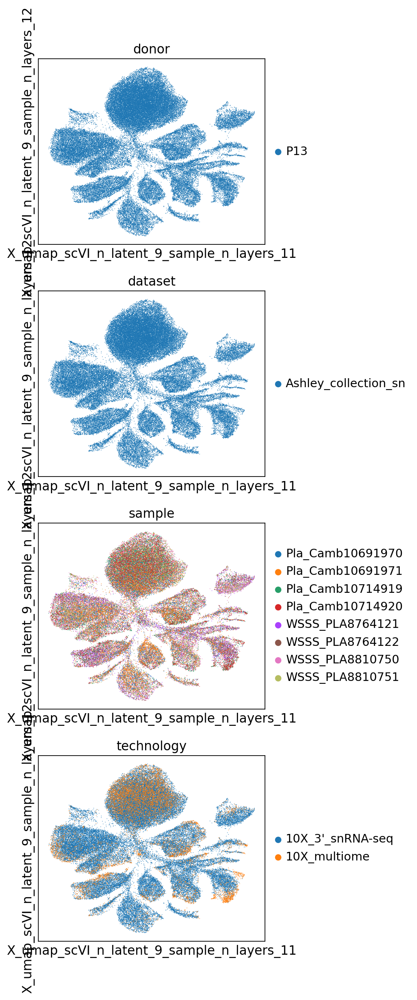

In [37]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

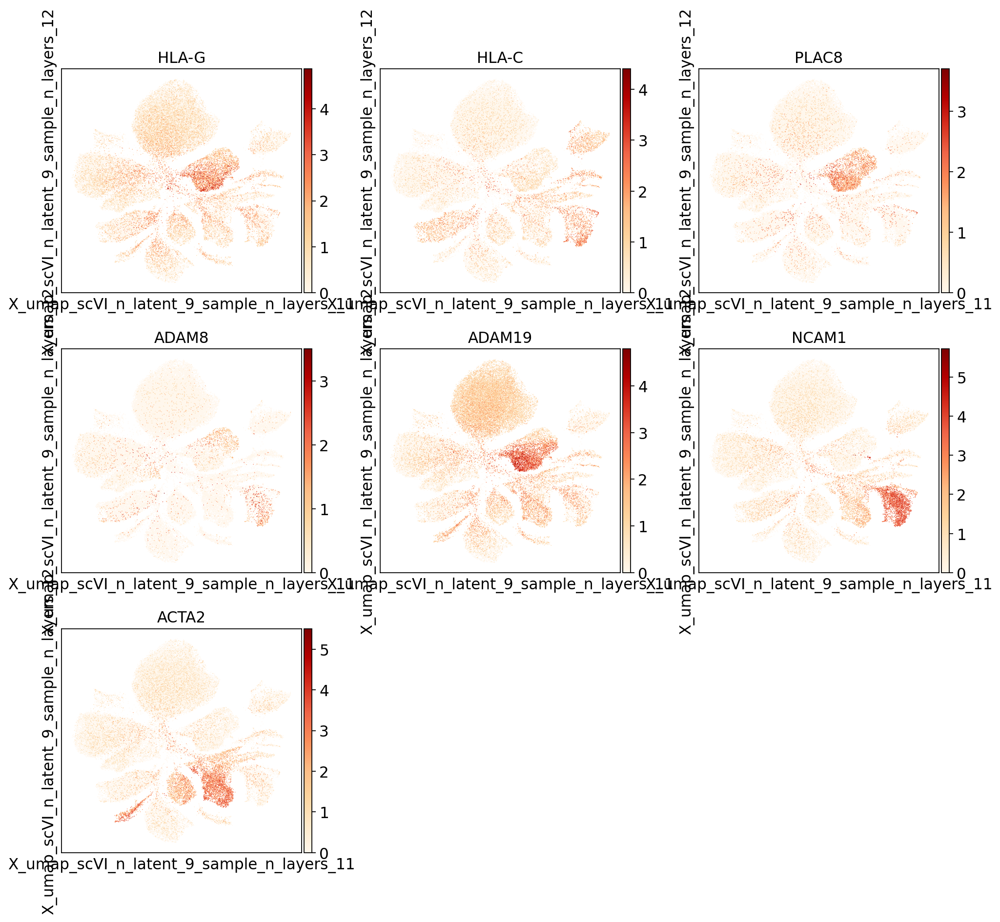

In [38]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

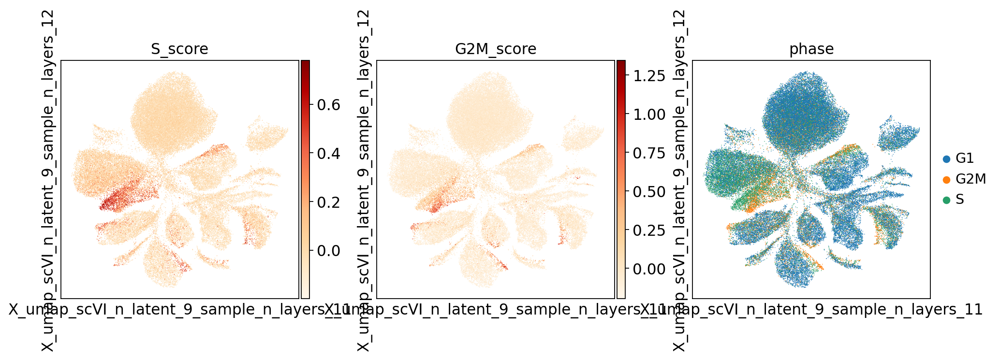

In [39]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [40]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

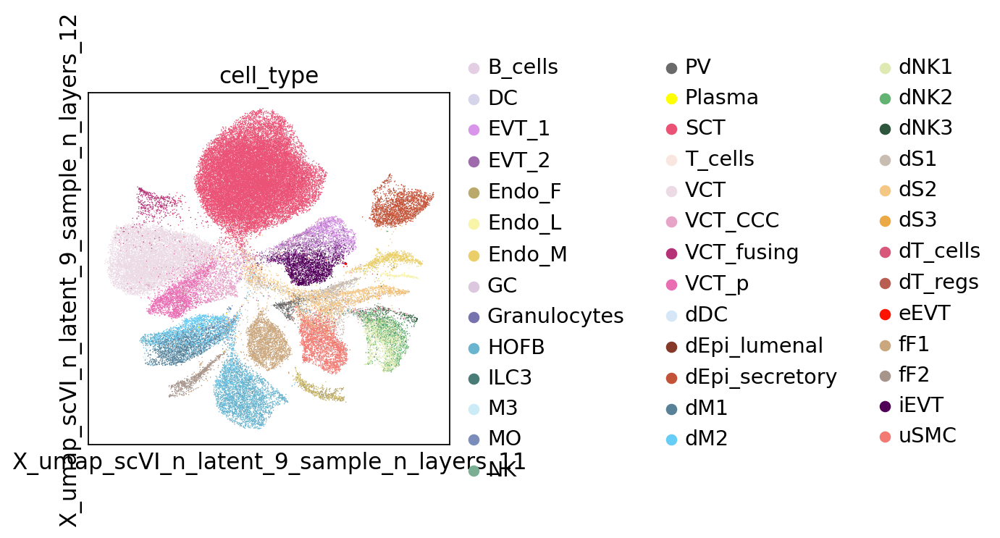

In [41]:
sc.pl.embedding(adata, curr_embedding_key,
                color='cell_type', palette=list(colors_final_df.loc[np.unique(adata.obs['cell_type']), 'color'])
               )

### scVI-corrected by `sample`

n_latent = 14, n_layers = 1

In [42]:
curr_embedding_key = 'X_umap_scVI_n_latent_14_sample_n_layers_1'

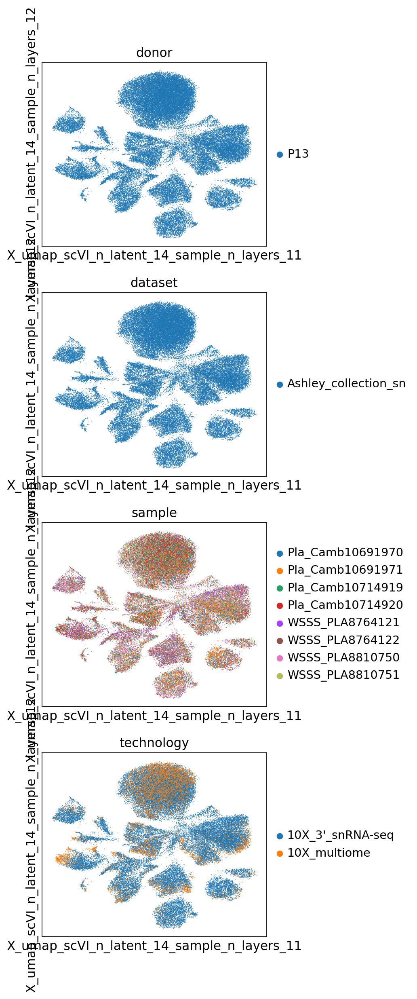

In [43]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

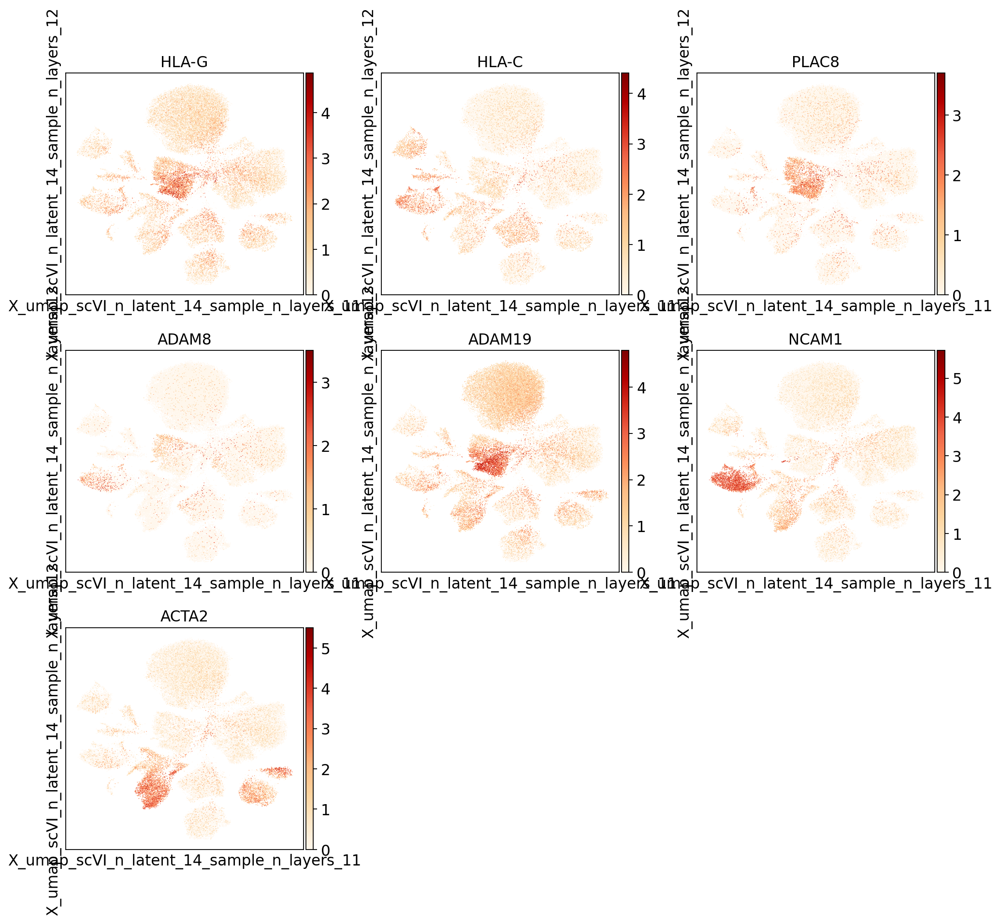

In [44]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

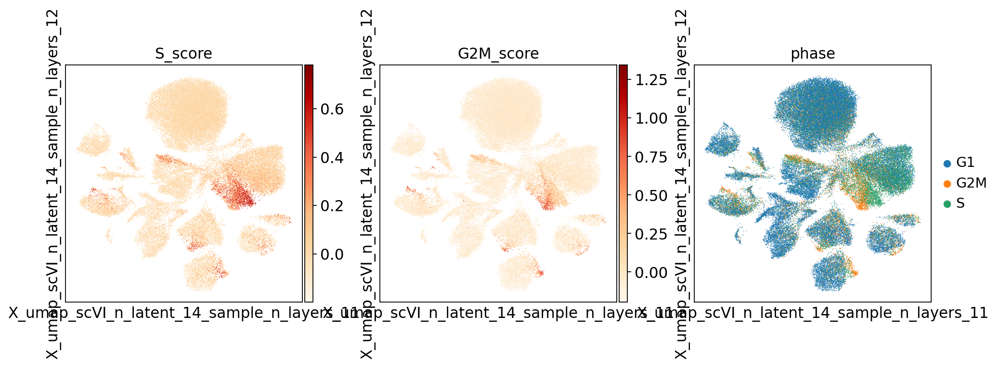

In [45]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [46]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

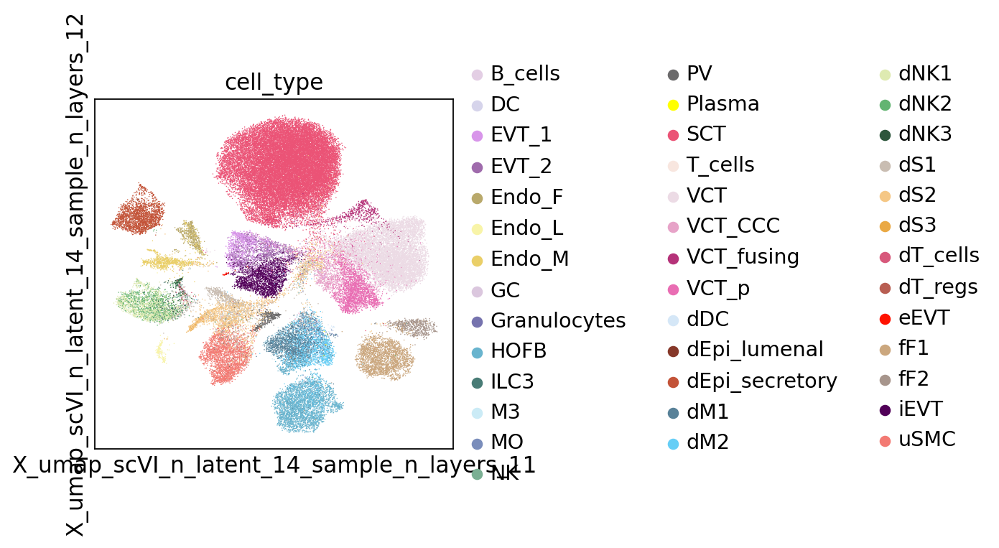

In [47]:
sc.pl.embedding(adata, curr_embedding_key,
                color='cell_type', palette=list(colors_final_df.loc[np.unique(adata.obs['cell_type']), 'color'])
               )

### scVI-corrected by `sample`

n_latent = 9, n_layers = 2

In [48]:
curr_embedding_key = 'X_umap_scVI_n_latent_9_sample_n_layers_2'

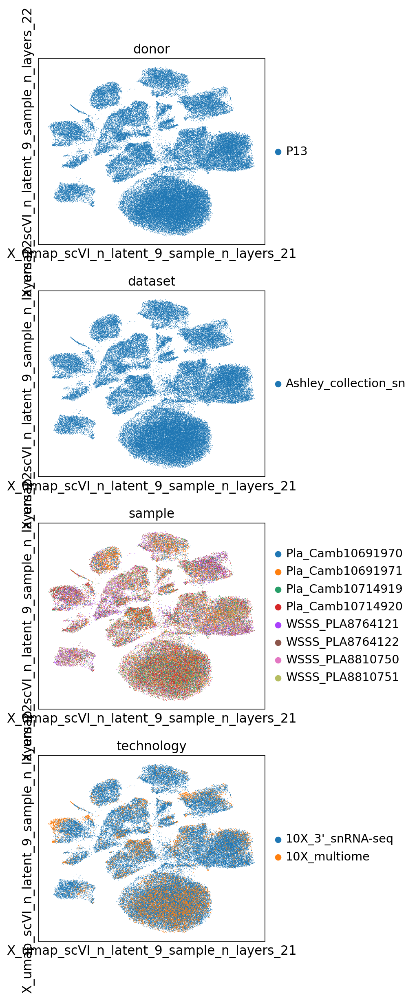

In [49]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

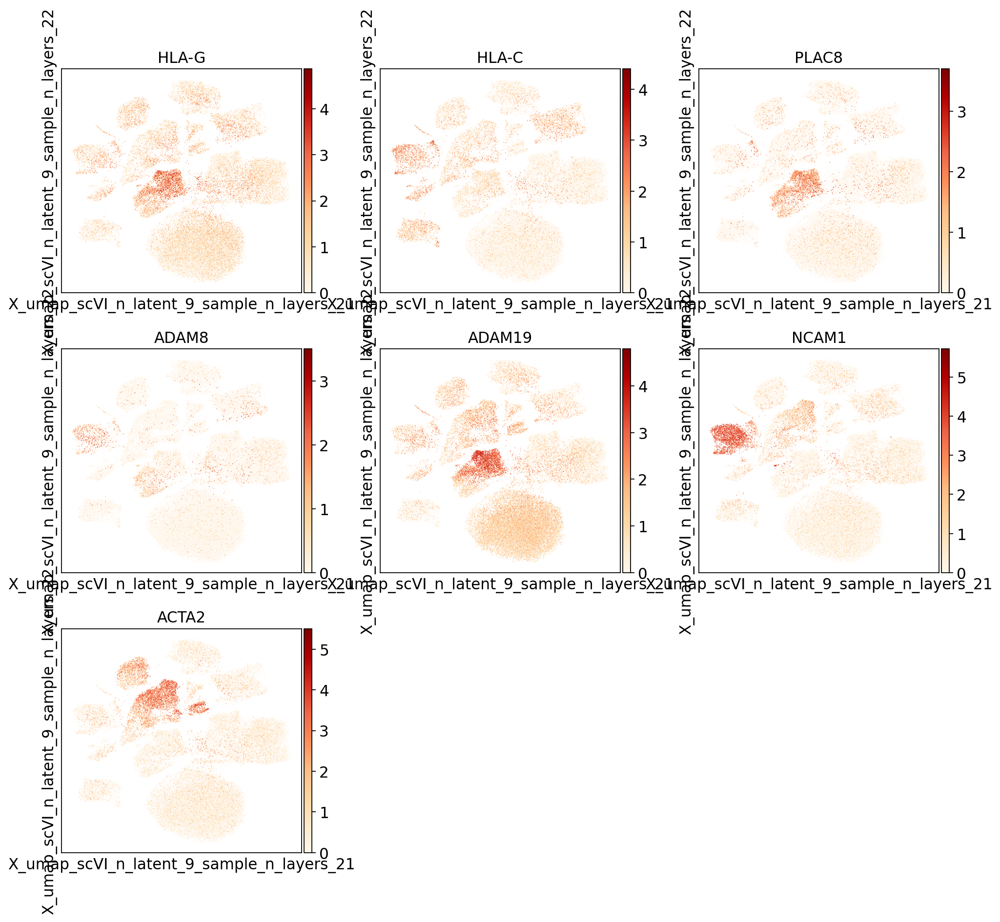

In [50]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

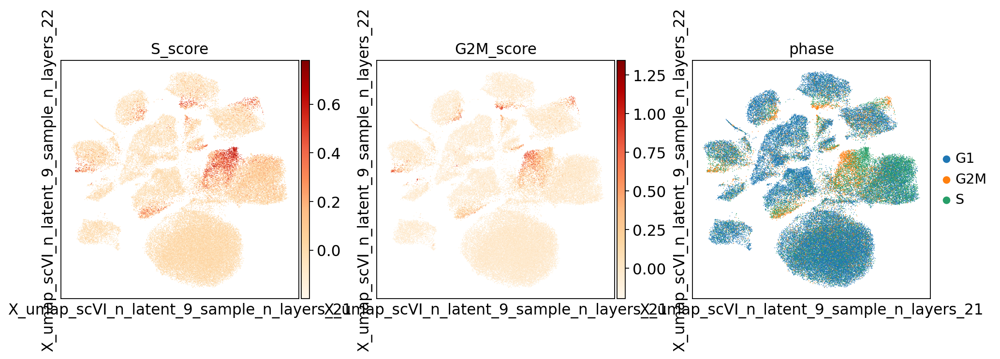

In [51]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [52]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

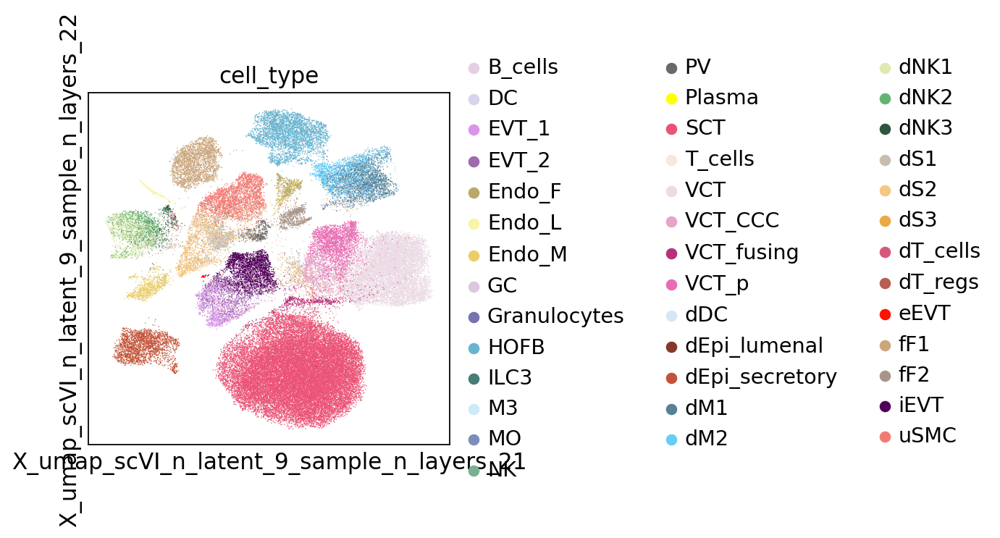

In [53]:
sc.pl.embedding(adata, curr_embedding_key,
                color='cell_type', palette=list(colors_final_df.loc[np.unique(adata.obs['cell_type']), 'color'])
               )

### scVI-corrected by `sample`

n_latent = 14, n_layers = 2

In [54]:
curr_embedding_key = 'X_umap_scVI_n_latent_14_sample_n_layers_2'

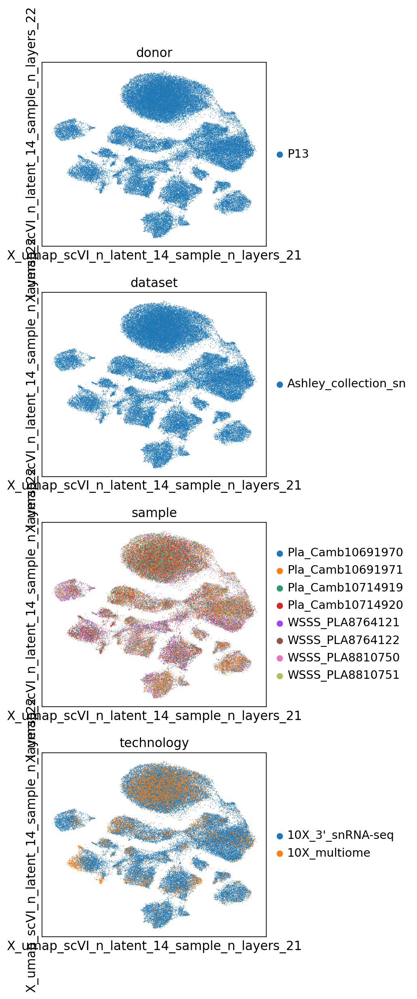

In [55]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

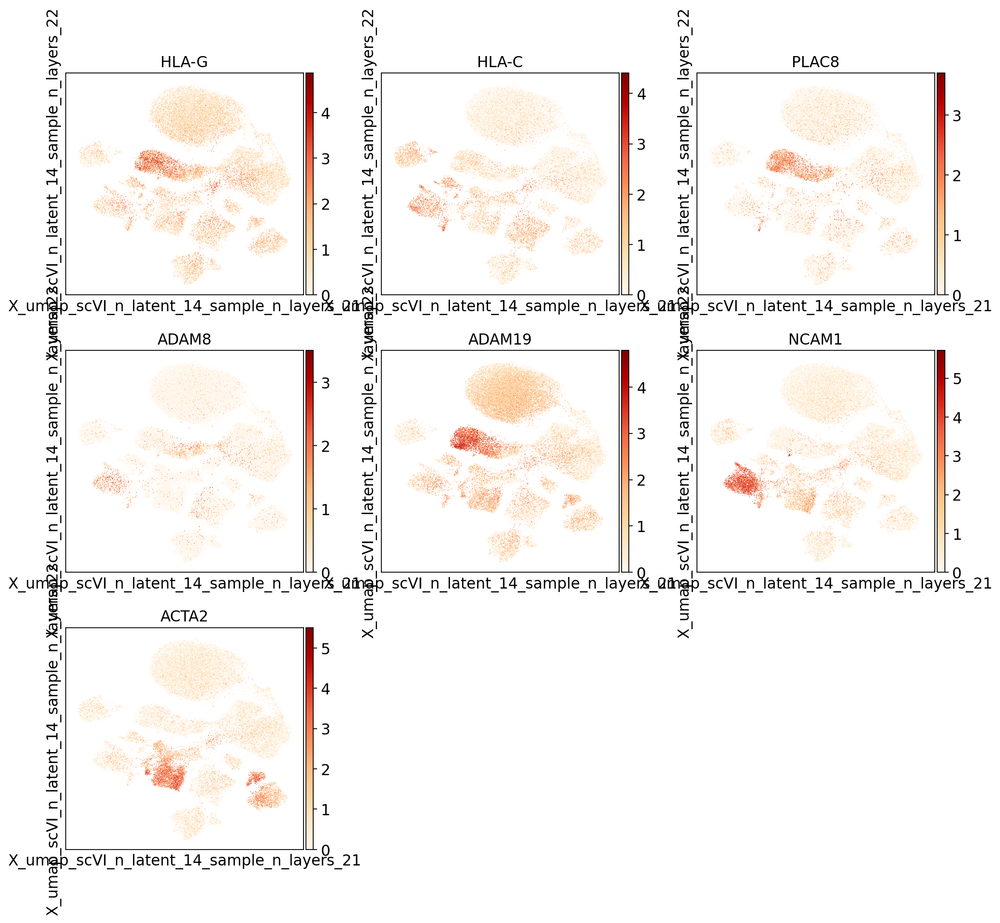

In [56]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

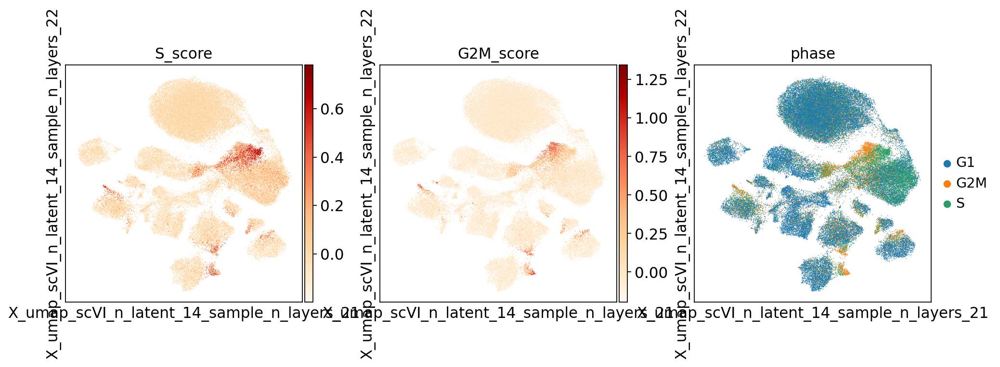

In [57]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [58]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

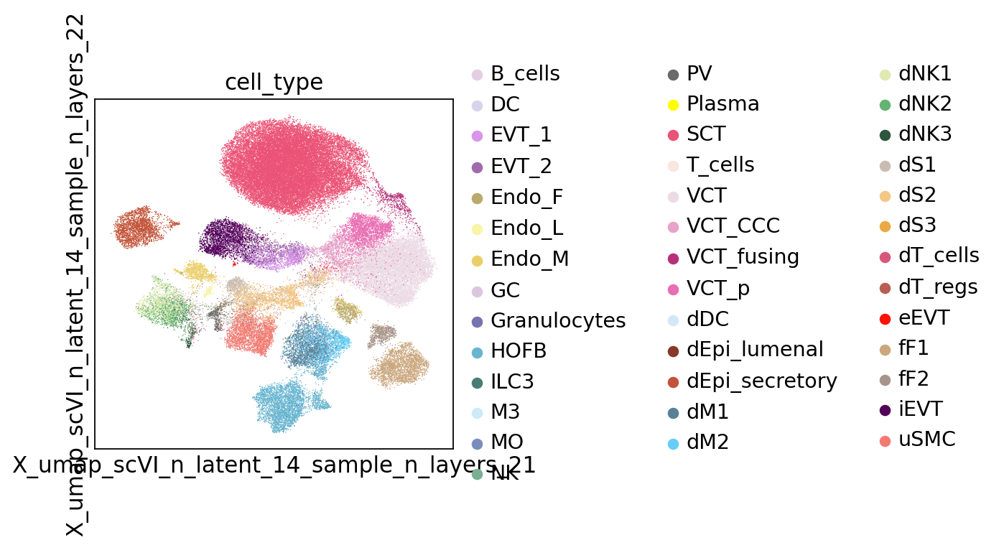

In [59]:
sc.pl.embedding(adata, curr_embedding_key,
                color='cell_type', palette=list(colors_final_df.loc[np.unique(adata.obs['cell_type']), 'color'])
               )

### scVI-corrected by `sample`

n_latent = 9, n_layers = 3

In [60]:
curr_embedding_key = 'X_umap_scVI_n_latent_9_sample_n_layers_3'

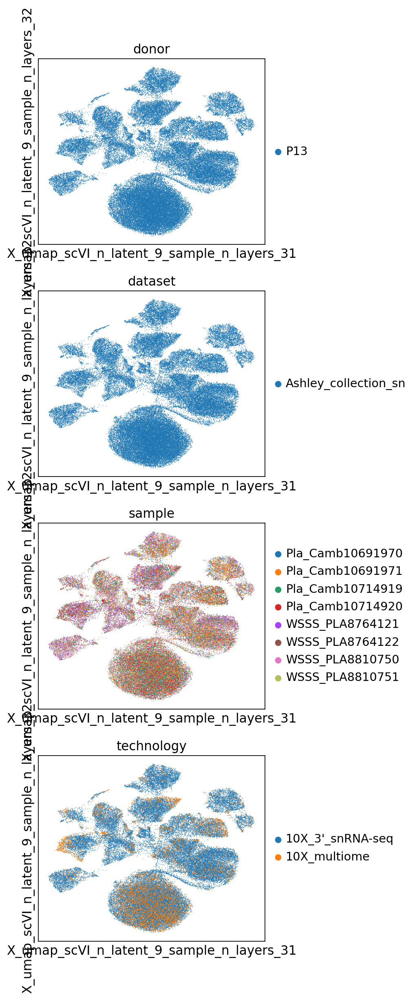

In [61]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

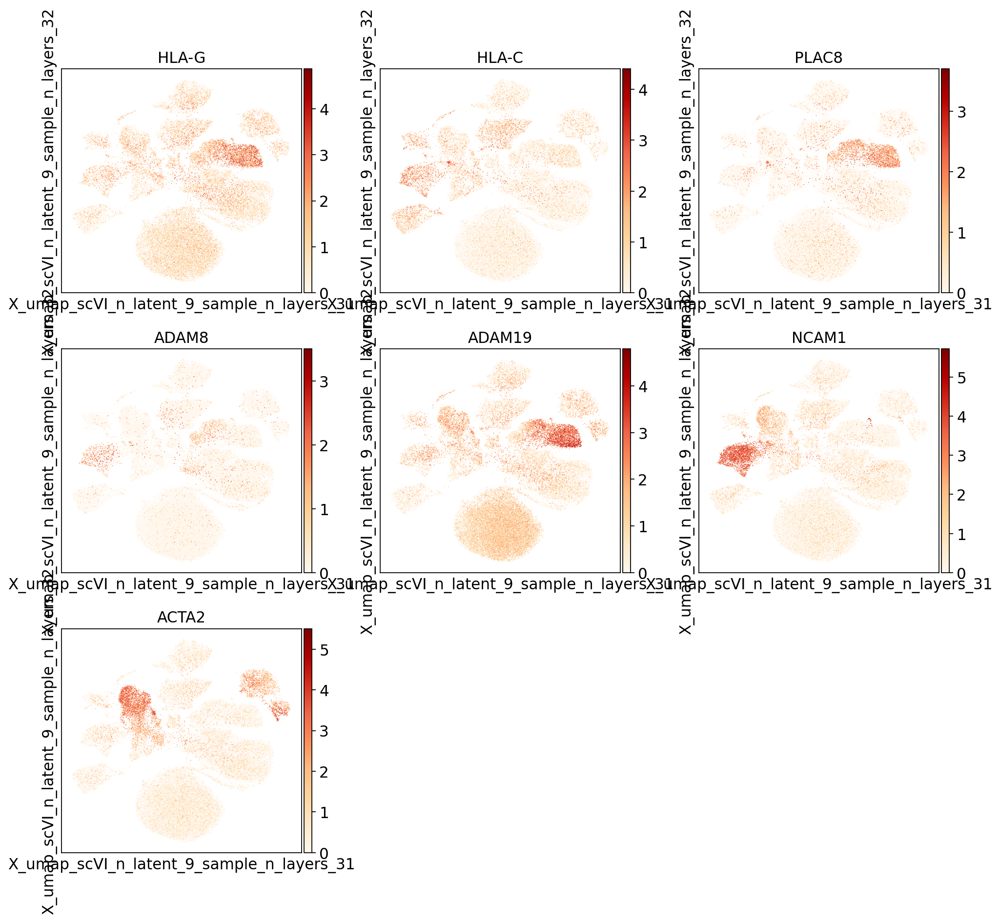

In [62]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

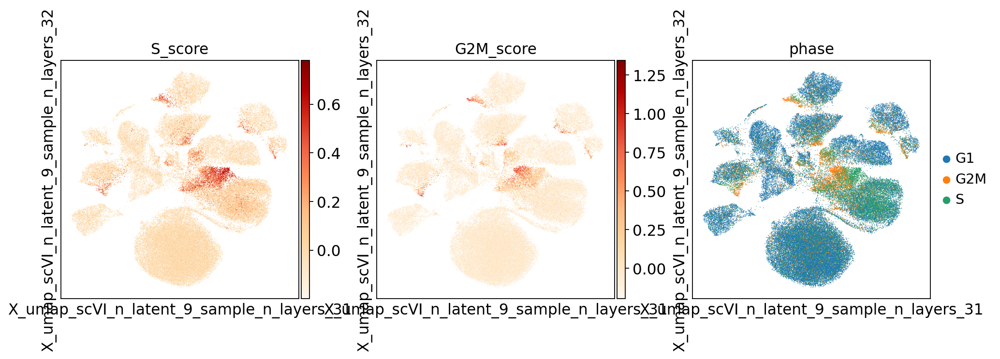

In [63]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [64]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

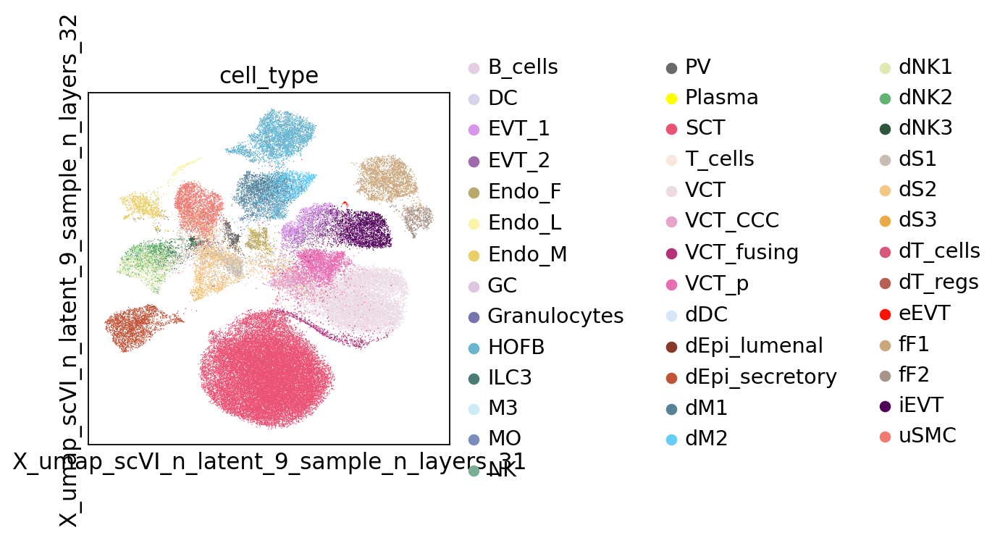

In [65]:
sc.pl.embedding(adata, curr_embedding_key,
                color='cell_type', palette=list(colors_final_df.loc[np.unique(adata.obs['cell_type']), 'color'])
               )

### scVI-corrected by `sample`

n_latent = 14, n_layers = 3

In [66]:
curr_embedding_key = 'X_umap_scVI_n_latent_14_sample_n_layers_3'

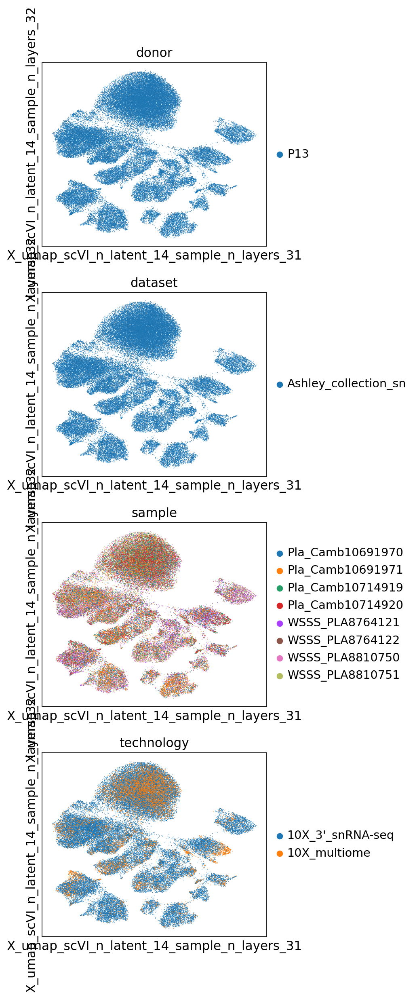

In [67]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

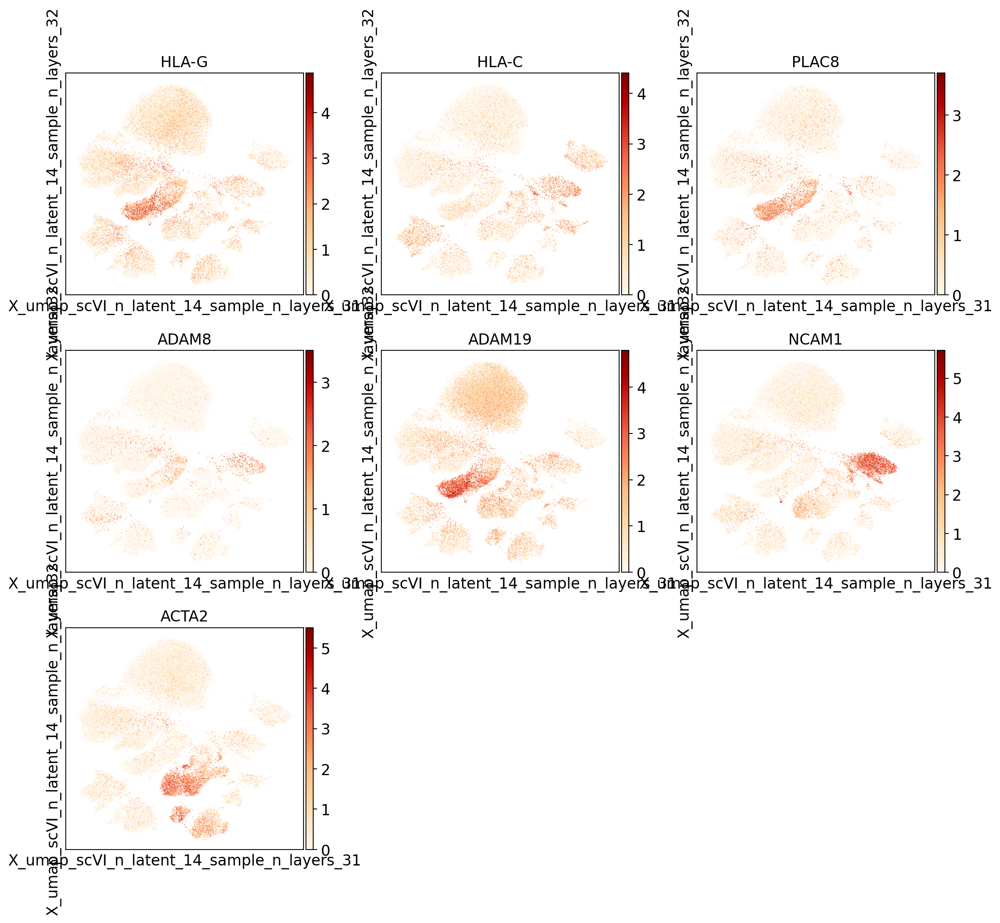

In [68]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

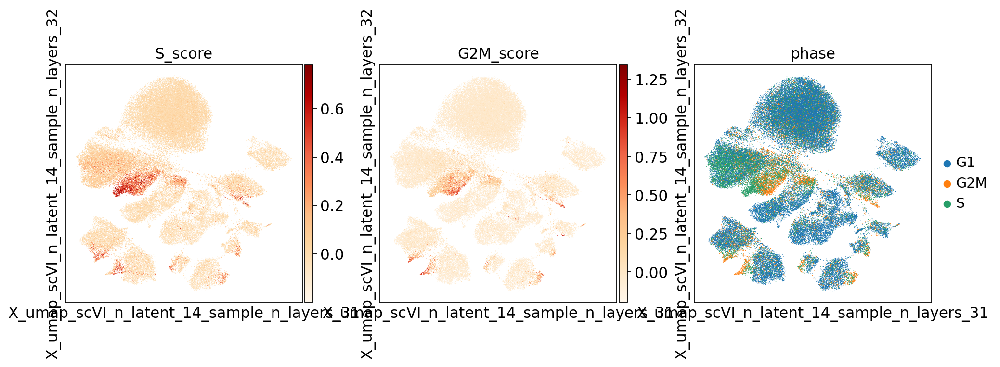

In [69]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [70]:
adata

AnnData object with n_obs × n_vars = 67821 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'cell_type', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 

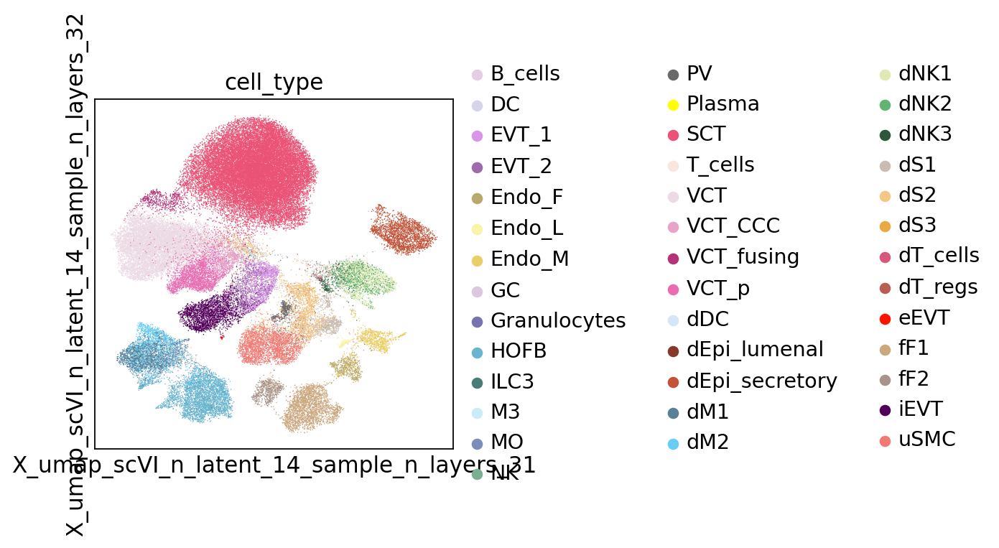

In [71]:
sc.pl.embedding(adata, curr_embedding_key,
                color='cell_type', palette=list(colors_final_df.loc[np.unique(adata.obs['cell_type']), 'color'])
               )

# all manifolds look alright here, just pick one